# Libs plus git repo cloning

In [1]:
!pip install numpy matplotlib opencv-python pillow

In [3]:
!git clone https://github.com/WastingT-me/Yandex-SOTA-2022.git

Cloning into 'Yandex-SOTA-2022'...
remote: Enumerating objects: 7, done.
remote: Counting objects: 100% (7/7), done.
remote: Compressing objects: 100% (6/6), done.
remote: Total 7 (delta 0), reused 4 (delta 0), pack-reused 0
Receiving objects: 100% (7/7), 21.47 MiB | 22.83 MiB/s, done.


In [4]:
cd /content/Yandex-SOTA-2022

/content/Yandex-SOTA-2022


In [5]:
import cv2
import matplotlib.pyplot as plt
from PIL import Image
import os
import numpy as np
from PIL import Image
from torchvision import transforms, models
from google.colab.patches import cv2_imshow
import random

preprocess = "thresh"

# Problem description & solving

To Do: классифицировать буквы на изображении с точностью 100%.

P.s.
Так как баллы засчитывались только при полном совпадении ответов, то было принято волевое решение отказаться от нейронок и ограничиться возможностями OpenCV.

Алгоритм решения:

1. Разрезаем цельное изображение сеткой на отдельные буквы $Img_i^j$;

2. Сравниваем с образцами алфавита $Sample_k$:
  >  A. Центрируем $Img_i^j$

  >  B. Поворачиваем $Img_i^j$ и считаем разницу с $Sample_k$ следующим образом:
  >
  >  1. Окрашиваем $Img_i^j$ в черно-белый цвет
  >
  >  2. Убираем контур в 1 пиксель у $Img_i^j$ - при повороте происходит размытие
  >
  > 3. Считаем расстояние между изображениями

  > С. Относим $Img_i^j$ к классу $argmin_k Diff(Img_i^j, Sample_k)$

In [ ]:
cv2_imshow(cv2.imread('letters.png'))

In [ ]:
!unzip Right.zip

Archive:  /content/Right.zip
   creating: Right/
 extracting: Right/A.png             
 extracting: Right/B.png             
 extracting: Right/C.png             
 extracting: Right/D.png             
 extracting: Right/E.png             
 extracting: Right/F.png             
 extracting: Right/G.png             
 extracting: Right/H.png             
 extracting: Right/I.png             
 extracting: Right/J.png             
 extracting: Right/K.png             
 extracting: Right/L.png             
 extracting: Right/M.png             
 extracting: Right/N.png             
 extracting: Right/O.png             
 extracting: Right/P.png             
 extracting: Right/Q.png             
 extracting: Right/R.png             
 extracting: Right/S.png             
 extracting: Right/T.png             
 extracting: Right/U.png             
 extracting: Right/V.png             
 extracting: Right/W.png             
 extracting: Right/X.png             
 extracting: Right/Y.png             
 

In [ ]:
def find_center(image_file):
    img = Image.open(image_file)
    img_mtx = img.load()
    top = bottom = 0
    first_row = True
    middle_row = middle_col = 0
    count = 0
    for row in range(img.size[0]):
        for col in range(img.size[1]):
            if img_mtx[row, col][0:3] != (255, 255, 255):
                middle_row += row
                middle_col += col
                count += 1
    middle_row = middle_row / count
    middle_col = middle_col / count

    return middle_row, middle_col

def shifting(img, i, j):
    h, w = img.shape[:2]
    translation_matrix = np.float32([[1, 0, -i + 43 ], [0, 1, -j + 43]])
    dst = cv2.warpAffine(img, translation_matrix, (w, h), borderValue =(255,255,255))
    return dst

def rotate_image(image, angle):
    image_center = tuple(np.array(image.shape[1::-1]) / 2)
    rot_mat = cv2.getRotationMatrix2D(image_center, angle, 1.0)
    result = cv2.warpAffine(image, rot_mat, image.shape[1::-1], flags=cv2.INTER_LINEAR, borderValue =(0,0,0))
    return result

def contur_to_black(image):
  w, h = image.shape[1::-1]
  new_image = image.copy()
  for i in range(1, w-1):
    for j in range(1, h-1):
      check = (image[i+1,j] == 0) or (image[i-1,j] == 0) or (image[i,j+1] == 0) or (image[i,j-1] == 0)
      if image[i,j] == 255 and check:
        new_image[i,j] = 0
  return new_image

def to_white(image):
  w, h = image.shape[1::-1]
  new_image = image.copy()
  for i in range(1, w-1):
    for j in range(1, h-1):
      if(image[i,j] == 0):
          new_image[i,j] = 0
      else:
          new_image[i,j] = 255
  return new_image

def our_check(image):
  w, h = image.shape[1::-1]
  new_image = image.copy()
  for i in range(1, w-1):
    for j in range(1, h-1):
      if image[i,j] == 255 or image[i,j] == 0:
        new_image[i,j] = 0
      else:
        new_image[i,j] = 255
  return new_image

In [ ]:
os.mkdir('MyLet')

In [ ]:
hype = sorted(os.listdir("Right"))
for way in hype:
    img1 = cv2.imread("Right/{}".format(way))
    img1 = rotate_image(img1, 5)
    PILimage = Image.fromarray(img1)
    PILimage.save('MyLet/{}'.format(way), dpi=(72,72))

In [ ]:
os.mkdir('IMG')

In [ ]:
im = cv2.imread("letters.png")
dimensions = im.shape

cutoff = dimensions[0] // 116
for i in range(116):
  for j in range(116):
    s = im[cutoff*j : cutoff*(j+1) , cutoff*i : cutoff*(i+1)]
    RGBimage = cv2.cvtColor(s, cv2.COLOR_BGR2RGB)
    PILimage = Image.fromarray(RGBimage)
    PILimage.save('IMG/IMG_{}x{}.png'.format(i,j), dpi=(72,72))
    image2 = cv2.imread('IMG/IMG_{}x{}.png'.format(i,j))
    k, l = find_center('IMG/IMG_{}x{}.png'.format(i,j))
    img = shifting(image2, k, l)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    img, img_bin = cv2.threshold(img,128,255,cv2.THRESH_BINARY | cv2.THRESH_OTSU)
    img = cv2.bitwise_not(img_bin)
    PILimage = Image.fromarray(img)
    PILimage.save('IMG/IMG_{}x{}.png'.format(i,j), dpi=(72,72))

In [ ]:
os.mkdir('Targets')

In [ ]:
import collections

e_letters = ['A.png', 'E.png', 'I.png', 'O.png', 'U.png', 'Y.png', 'B.png', 'C.png', 'D.png', 'F.png', 'G.png', 'H.png', 'J.png', 'K.png', 'L.png', 'M.png', 'N.png', 'P.png', 'Q.png', 'R.png', 'S.png', 'T.png', 'V.png', 'W.png', 'X.png', 'Z.png']
count_letters2 = dict()
for e_letter in e_letters:
    count_letters2[e_letter] = 0
count_letters2 = collections.OrderedDict(sorted(count_letters2.items()))

dire = sorted(os.listdir("IMG"))
print(len(dire))
res2 = []
hype = sorted(os.listdir("Right"))
i = 0
for way in dire:
    img1 = cv2.imread("IMG/{}".format(way))
    img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
    dist = np.zeros((360 // 5, 26))
    j = 0
    for file in hype:
        img2 = cv2.imread(r"Right/{}".format(file))
        img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)
        for n in range(360 // 5):
            img3 = img1.copy()
            img3 = rotate_image(img3, n*5)
            _, img_bin = cv2.threshold(img3,127,255, cv2.THRESH_BINARY_INV)
            gray = cv2.bitwise_not(img_bin)
            distance = abs(np.sum(gray - img2))
            if(distance // 255 < 100):
                notwhiteshit = contur_to_black(to_white(np.abs(gray - img2)))
                dist[n][j] = (abs(np.sum(notwhiteshit)))
            else:
                dist[n][j] = (abs(np.sum(gray - img2)))
        j+=1
    r = np.where(dist == np.amin(dist))[1][0]
    count_letters2[hype[r]] +=1
    res2.append(r)
    i+=1
    if(i%100 == 0):
        print(i)

In [ ]:
sum = 0
for key in count_letters2.keys():
  print(key[0], count_letters2[key])
  sum+=count_letters2[key]
print(sum)

A 661
B 22
C 330
D 892
E 88
F 969
G 789
H 310
I 369
J 485
K 336
L 1033
M 147
N 140
O 1059
P 613
Q 607
R 385
S 175
T 414
U 631
V 714
W 1088
X 361
Y 708
Z 130
13456


# Trials

Главная неочевидная проблема - размытие при повороте. В итоге черно-белое изображение перестает быть таковым.

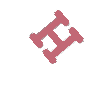

In [ ]:
image = cv2.imread('IMG/IMG_101x69.png')
cv2_imshow(image)

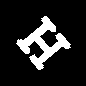

In [ ]:
image_center = find_center('IMG/IMG_101x69.png')
image = shifting(image, image_center[0], image_center[1])
gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
gray, img_bin = cv2.threshold(gray,128,255,cv2.THRESH_BINARY | cv2.THRESH_OTSU)
gray = cv2.bitwise_not(img_bin)
cv2_imshow(gray)

In [ ]:
dict_S_letters = dict()
dict_angle_letters = dict()
for e_letter in e_letters:
    e_image = cv2.imread("Right/{}".format(e_letter), cv2.IMREAD_GRAYSCALE)
    S_min = np.inf
    for angle in range(360//5):
      rot_image = rotate_image(gray, angle*5)

      _, img_bin = cv2.threshold(rot_image,127,255, cv2.THRESH_BINARY_INV)
      rot_image = cv2.bitwise_not(img_bin)

      S = np.sum(np.abs(rot_image - e_image))
      if S < S_min:
        S_min = S
        angle_min = angle*5
    dict_angle_letters[e_letter] = angle_min
    dict_S_letters[e_letter] = S_min

Наглядный пример

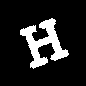

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


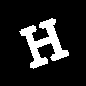

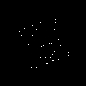

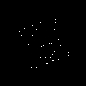

In [ ]:
rot_image = rotate_image(gray, dict_angle_letters['H.png'])
_, img_bin = cv2.threshold(rot_image,127,255, cv2.THRESH_BINARY_INV)
rot_image = cv2.bitwise_not(img_bin)
cv2_imshow(rot_image)
print(rot_image)
e_image = cv2.imread("Right/H.png".format(e_letter), cv2.IMREAD_GRAYSCALE)
cv2_imshow(e_image)
cv2_imshow(np.abs(-rot_image + e_image))
np.sum(rot_image - e_image)

notwhiteshit = np.abs(-rot_image + e_image)
cv2_imshow(notwhiteshit)

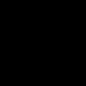

0

In [ ]:
cv2_imshow(contur_to_black(to_white(notwhiteshit)))
np.sum(contur_to_black(to_white(notwhiteshit)))

Из-за размытия при повороте H попадает в класс N

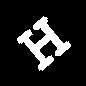

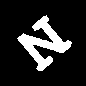

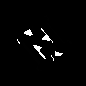

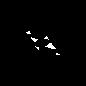

21165

In [ ]:
rot_image = rotate_image(gray, dict_angle_letters['N'])
_, img_bin = cv2.threshold(rot_image,127,255, cv2.THRESH_BINARY_INV)
rot_image = cv2.bitwise_not(img_bin)
cv2_imshow(rot_image)

e_image = cv2.imread("Right/N.png".format(e_letter), cv2.IMREAD_GRAYSCALE)
cv2_imshow(e_image)
cv2_imshow(np.abs(rot_image - e_image))
np.sum(np.abs(rot_image - e_image))

cv2_imshow(contur_to_black(to_white(np.abs(rot_image - e_image))))
np.sum(contur_to_black(to_white(np.abs(rot_image - e_image))))

In [ ]:
21165 // 255

83

46398


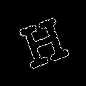

46143

In [ ]:
dif = np.abs(rot_image - e_image)
print(np.sum(dif))
e_image2 = contur_to_black(dif)
cv2_imshow(e_image2)
np.sum(e_image2)

Но если убрать контур - то все ок

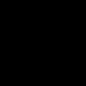

In [ ]:
gray, img_bin = cv2.threshold(e_image,127,255, cv2.THRESH_BINARY_INV)
gray = cv2.bitwise_not(img_bin)
cv2_imshow(our_check(gray))